<a href="https://colab.research.google.com/github/jrgosalvez/data255_DL/blob/main/HW6-CycleGAN/Cycle_GAN_Implementation_in_PyTorch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importing required libraries

In [ ]:
!pip install torch_snippets torch_summary --quiet
import itertools
from PIL import Image
from torch_snippets import *
from torchvision import transforms
from torchvision.utils import make_grid
from torchsummary import summary

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.6/79.6 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 kB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 9.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 204.2/204.2 kB 12.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.4/4.4 MB 30.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 43.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.9/98.9 kB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 52.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.6/30.6 MB 43.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 177.4/177.4 kB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 33.4 MB/s eta 0:0

In [ ]:
# prompt: mount drive

from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


### Looking at what the shape of our training images are

In [ ]:
img = Image.open('/content/drive/MyDrive/DLHW6/testA/00500.jpg')
img.size

(256, 256)

### Defining image transformations (augmentation)

In [ ]:
IMAGE_SIZE = 256
device = 'cuda' if torch.cuda.is_available() else 'cpu'
transform = transforms.Compose([
    transforms.Resize(int(IMAGE_SIZE*1.33)),
    transforms.RandomCrop((IMAGE_SIZE,IMAGE_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

### Making our Train and Test Dataset

In [ ]:
class Monet2PhotoDataset(Dataset):
    def __init__(self, monets, photos):
        ### getting the list of images
        self.monets = Glob(monets)
        self.photos = Glob(photos)

    def __getitem__(self, ix):
        monet = self.monets[ix % len(self.monets)]
        ### Choosing a random photo image to pair with the chosen monet image
        photo = choose(self.photos)
        monet = Image.open(monet).convert('RGB')
        photo = Image.open(photo).convert('RGB')
        return monet, photo

    def __len__(self):
      #print(max(len(self.monets), len(self.photos)))
      return max(len(self.monets), len(self.photos))
    def choose(self): return self[randint(len(self))]

    def collate_fn(self, batch): #batch function
        ### The zip function breaks the tuples into two lists
        srcs, trgs = list(zip(*batch))

        srcs = torch.cat([transform(img)[None] for img in srcs], 0).to(device).float()
        trgs = torch.cat([transform(img)[None] for img in trgs], 0).to(device).float()
        return srcs.to(device), trgs.to(device)

### Initializing the Data Loader

In [ ]:
trn_ds = Monet2PhotoDataset('/content/drive/MyDrive/DLHW6/testA', '/content/drive/MyDrive/DLHW6/trainB')
val_ds = Monet2PhotoDataset('/content/drive/MyDrive/DLHW6/testA', '/content/drive/MyDrive/DLHW6/testB')

trn_dl = DataLoader(trn_ds, batch_size=1, shuffle=True, collate_fn=trn_ds.collate_fn)
val_dl = DataLoader(val_ds, batch_size=5, shuffle=True, collate_fn=val_ds.collate_fn)

# Defining our CYCLE GAN

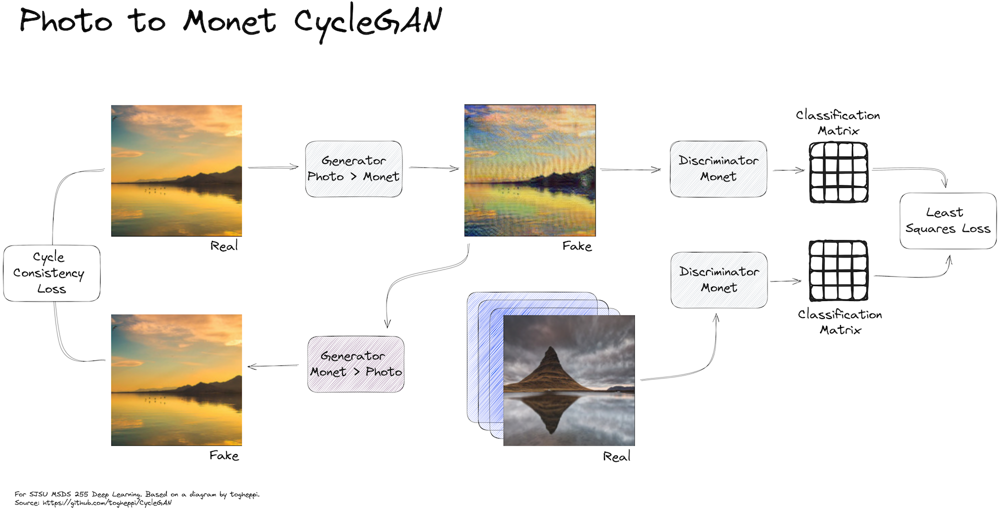

###

In [ ]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        if hasattr(m, "bias") and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)

### Defining a Residual Block

In [8]:
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
        )

    def forward(self, x):
        return x + self.block(x)

![generator and discriminator](https://www.researchgate.net/publication/343075688/figure/fig3/AS:916527951917056@1595528700573/Architecture-of-the-generator-and-discriminator-of-unpaired-CycleGAN-Conv-2D.ppm)

### Generator Class

In [9]:
class GeneratorResNet(nn.Module):
    def __init__(self, num_residual_blocks=9):
        super(GeneratorResNet, self).__init__()
        out_features = 64
        channels = 3
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(channels, out_features, 7),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(inplace=True),
        ]
        in_features = out_features
        # Downsampling
        for _ in range(2):
            out_features *= 2
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Residual blocks
        for _ in range(num_residual_blocks):
            model += [ResidualBlock(out_features)]

        # Upsampling
        for _ in range(2):
            out_features //= 2
            model += [
                nn.Upsample(scale_factor=2),
                nn.Conv2d(in_features, out_features, 3, stride=1, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Output layer
        model += [nn.ReflectionPad2d(channels), nn.Conv2d(out_features, channels, 7), nn.Tanh()]
        self.model = nn.Sequential(*model)
        self.apply(weights_init_normal)
    def forward(self, x):
        return self.model(x)

### Discriminator Class

In [10]:
# PatchGAN to discriminate on patches of the data

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        channels, height, width = 3, IMAGE_SIZE, IMAGE_SIZE

        def discriminator_block(in_filters, out_filters, normalize=True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, 4, padding=1)
        )
        self.apply(weights_init_normal)

    def forward(self, img):
        return self.model(img)

### How do we generate samples from our Cycle GAN

In [11]:
@torch.no_grad()
def generate_sample():
    data = next(iter(val_dl))
    G_AB.eval()
    G_BA.eval()

    real_A, real_B = data
    fake_B = G_AB(real_A)
    fake_A = G_BA(real_B)
    # Arange images along x-axis
    real_A = make_grid(real_A, nrow=5, normalize=True)
    real_B = make_grid(real_B, nrow=5, normalize=True)
    fake_A = make_grid(fake_A, nrow=5, normalize=True)
    fake_B = make_grid(fake_B, nrow=5, normalize=True)
    # Arange images along y-axis
    image_grid = torch.cat((real_A, fake_B, real_B, fake_A), 1)
    show(image_grid.detach().cpu().permute(1,2,0).numpy(), sz=12)

### Defining the Generator Training Step

In [12]:
def generator_train_step(Gs, optimizer, real_A, real_B):
    G_AB, G_BA = Gs
    optimizer.zero_grad()
    loss_id_A = criterion_identity(G_BA(real_A), real_A)
    loss_id_B = criterion_identity(G_AB(real_B), real_B)

    loss_identity = (loss_id_A + loss_id_B) / 2
    fake_B = G_AB(real_A)
    loss_GAN_AB = criterion_GAN(D_B(fake_B), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))
    fake_A = G_BA(real_B)
    loss_GAN_BA = criterion_GAN(D_A(fake_A), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))

    loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2
    recov_A = G_BA(fake_B)
    loss_cycle_A = criterion_cycle(recov_A, real_A)
    recov_B = G_AB(fake_A)
    loss_cycle_B = criterion_cycle(recov_B, real_B)

    loss_cycle = (loss_cycle_A + loss_cycle_B) / 2
    loss_G = loss_GAN + lambda_cyc * loss_cycle + lambda_id * loss_identity
    loss_G.backward()
    optimizer.step()
    return loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B

### Defining the Discriminator Training Step

In [13]:
def discriminator_train_step(D, real_data, fake_data, optimizer):
    optimizer.zero_grad()
    loss_real = criterion_GAN(D(real_data), torch.Tensor(np.ones((len(real_data), 1, 16, 16))).to(device))
    loss_fake = criterion_GAN(D(fake_data.detach()), torch.Tensor(np.zeros((len(real_data), 1, 16, 16))).to(device))
    loss_D = (loss_real + loss_fake) / 2
    loss_D.backward()
    optimizer.step()
    return loss_D

In [14]:
G_AB = GeneratorResNet().to(device)
G_BA = GeneratorResNet().to(device)
D_A = Discriminator().to(device)
D_B = Discriminator().to(device)

criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

optimizer_G = torch.optim.Adam(
    itertools.chain(G_AB.parameters(), G_BA.parameters()), lr=0.0002, betas=(0.5, 0.999)
)
optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

lambda_cyc, lambda_id = 10.0, 5.0

### Training the CYCLE GAN. Increase the number of epochs for better results

EPOCH: 1.000  loss_D: 0.167  loss_G: 3.724  loss_GAN: 0.571  loss_cycle: 0.205  loss_identity: 0.220  (3664.06s - 87937.35s remaining)

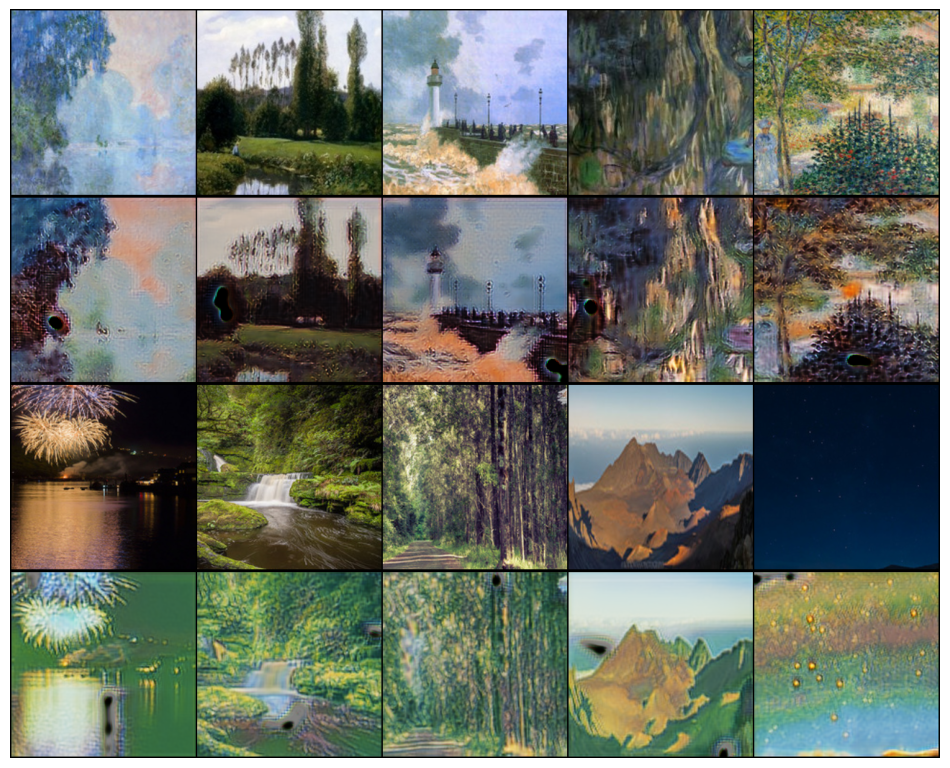

EPOCH: 1.000  loss_G: 4.000  loss_GAN: 0.562  loss_D: 0.204  loss_cycle: 0.236  loss_identity: 0.217  (3667.32s - 88015.59s remaining)
EPOCH: 2.000  loss_D: 0.189  loss_G: 3.833  loss_GAN: 0.652  loss_cycle: 0.222  loss_identity: 0.192  (5844.38s - 67210.33s remaining)

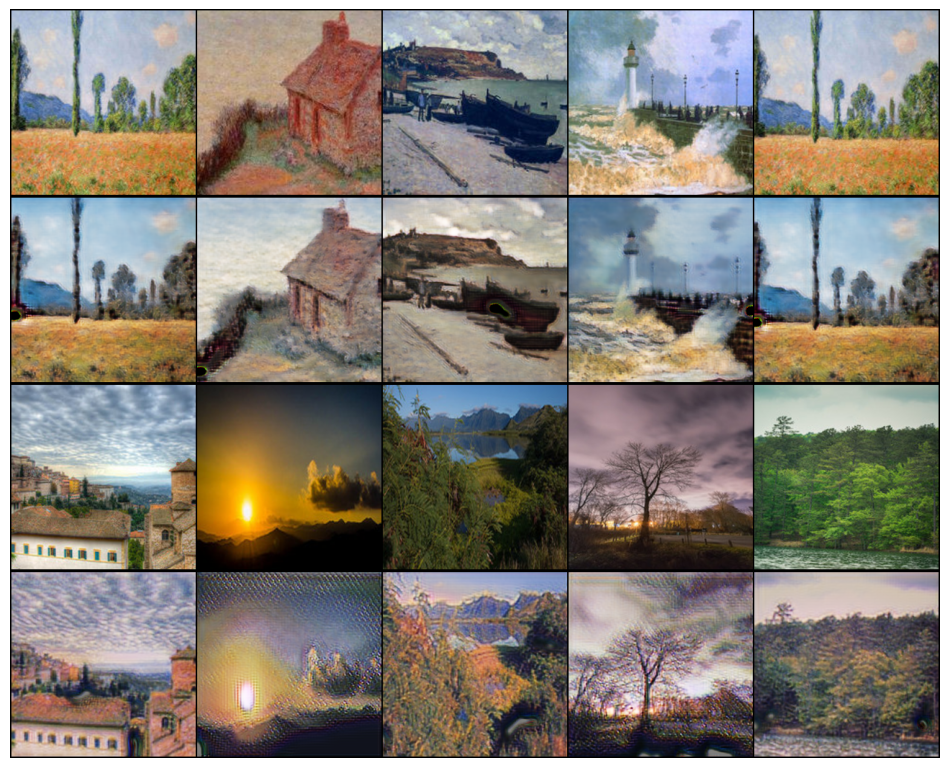

EPOCH: 2.000  loss_G: 3.271  loss_GAN: 0.539  loss_D: 0.193  loss_cycle: 0.187  loss_identity: 0.172  (5847.65s - 67247.98s remaining)
EPOCH: 3.000  loss_D: 0.079  loss_G: 2.698  loss_GAN: 0.810  loss_cycle: 0.131  loss_identity: 0.117  (7579.51s - 55583.04s remaining)

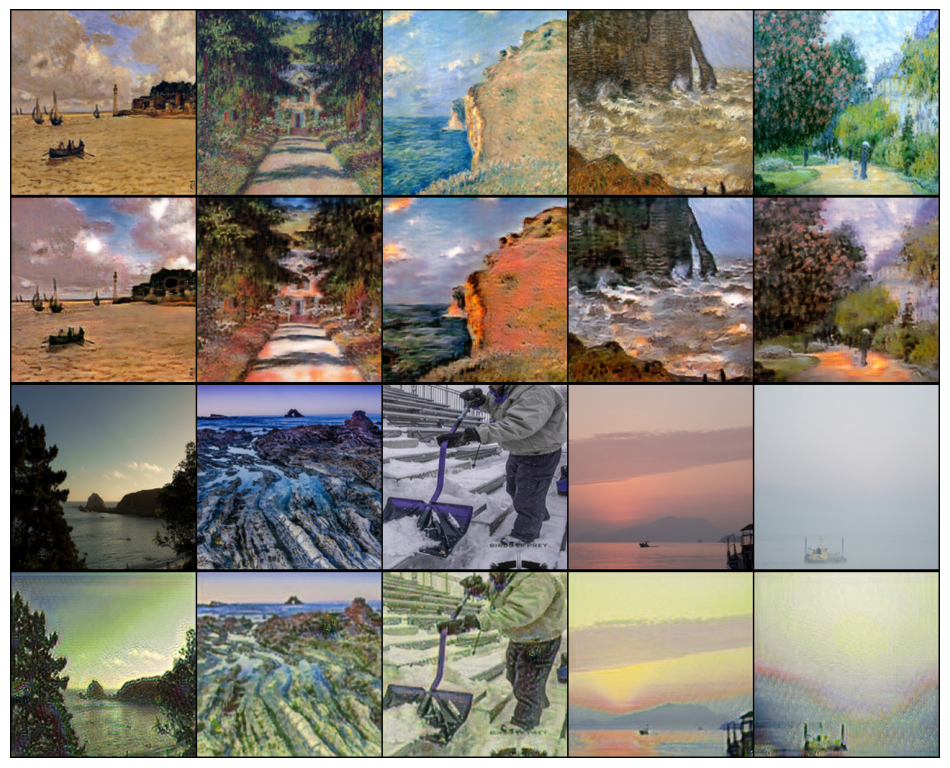

EPOCH: 3.000  loss_G: 3.070  loss_GAN: 0.593  loss_D: 0.170  loss_cycle: 0.169  loss_identity: 0.157  (7582.77s - 55606.95s remaining)
EPOCH: 4.000  loss_D: 0.140  loss_G: 2.467  loss_GAN: 0.743  loss_cycle: 0.119  loss_identity: 0.107  (9114.02s - 47848.59s remaining)

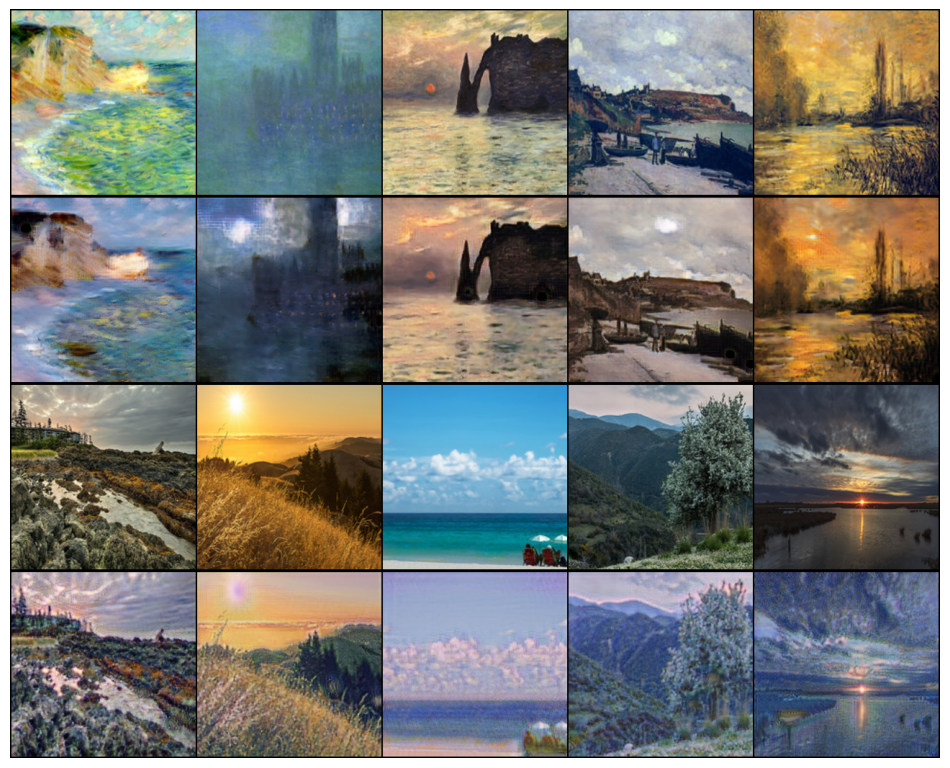

EPOCH: 4.000  loss_G: 2.958  loss_GAN: 0.624  loss_D: 0.156  loss_cycle: 0.160  loss_identity: 0.147  (9117.72s - 47868.02s remaining)
EPOCH: 5.000  loss_D: 0.112  loss_G: 3.734  loss_GAN: 0.445  loss_cycle: 0.178  loss_identity: 0.302  (10586.76s - 42347.03s remaining)

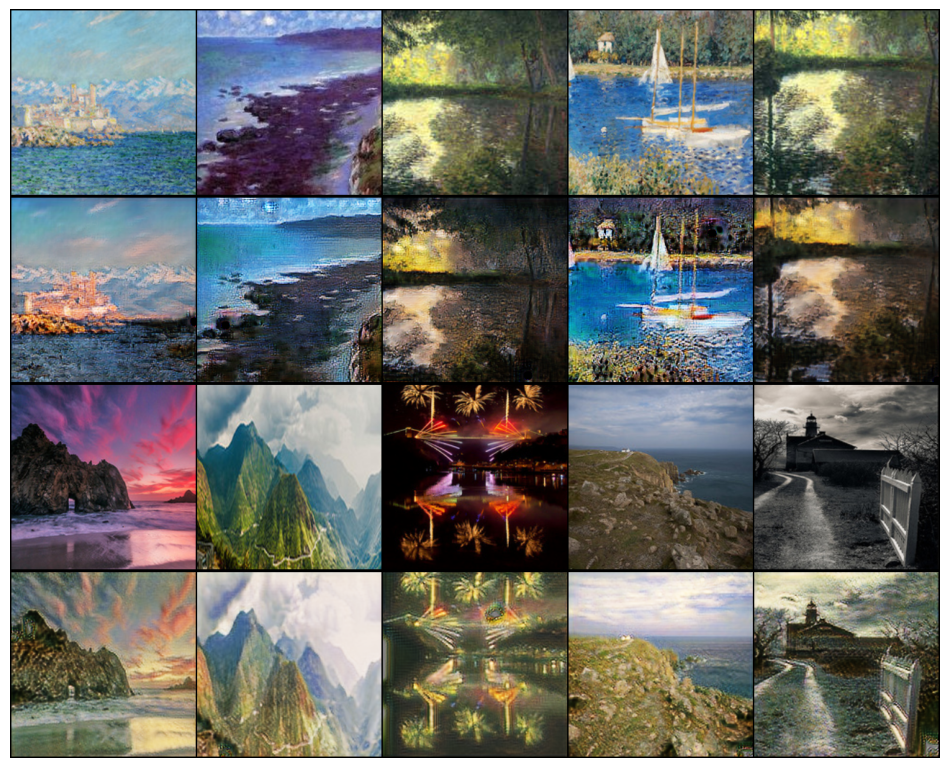

EPOCH: 5.000  loss_G: 2.886  loss_GAN: 0.644  loss_D: 0.147  loss_cycle: 0.153  loss_identity: 0.142  (10590.18s - 42360.73s remaining)
EPOCH: 6.000  loss_D: 0.082  loss_G: 3.341  loss_GAN: 0.525  loss_cycle: 0.180  loss_identity: 0.204  (12042.93s - 38135.94s remaining)

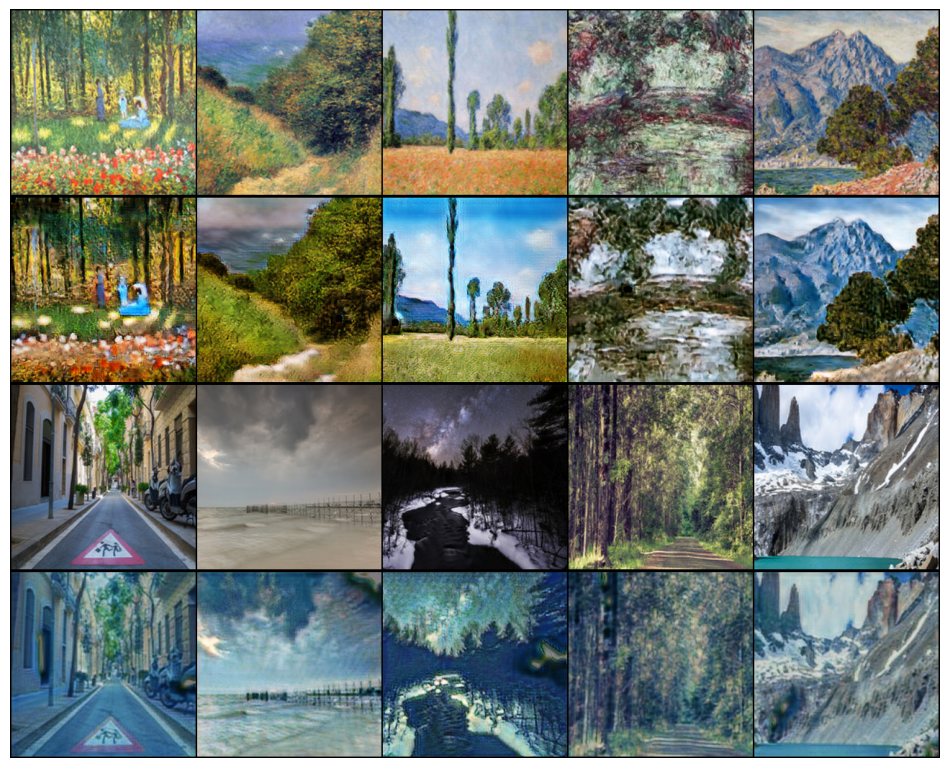

EPOCH: 6.000  loss_G: 2.842  loss_GAN: 0.669  loss_D: 0.137  loss_cycle: 0.148  loss_identity: 0.138  (12045.84s - 38145.16s remaining)
EPOCH: 7.000  loss_D: 0.114  loss_G: 2.290  loss_GAN: 0.545  loss_cycle: 0.126  loss_identity: 0.097  (13490.48s - 34689.80s remaining)

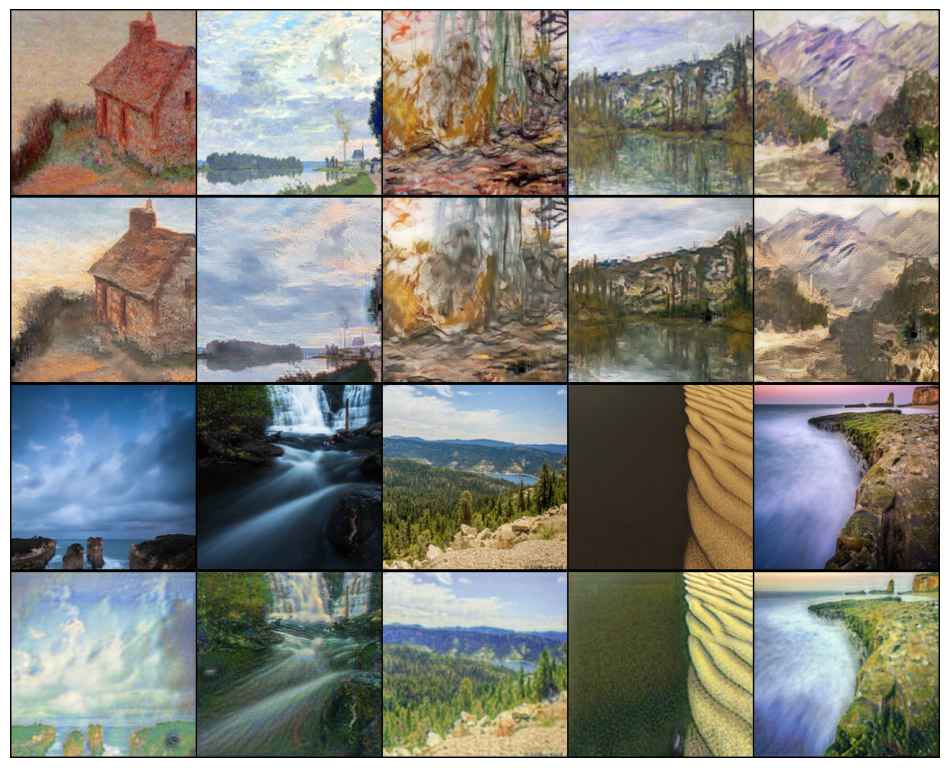

EPOCH: 7.000  loss_G: 2.826  loss_GAN: 0.680  loss_D: 0.132  loss_cycle: 0.147  loss_identity: 0.136  (13493.90s - 34698.60s remaining)
EPOCH: 8.000  loss_D: 0.041  loss_G: 2.678  loss_GAN: 0.838  loss_cycle: 0.128  loss_identity: 0.111  (14934.04s - 31734.83s remaining)

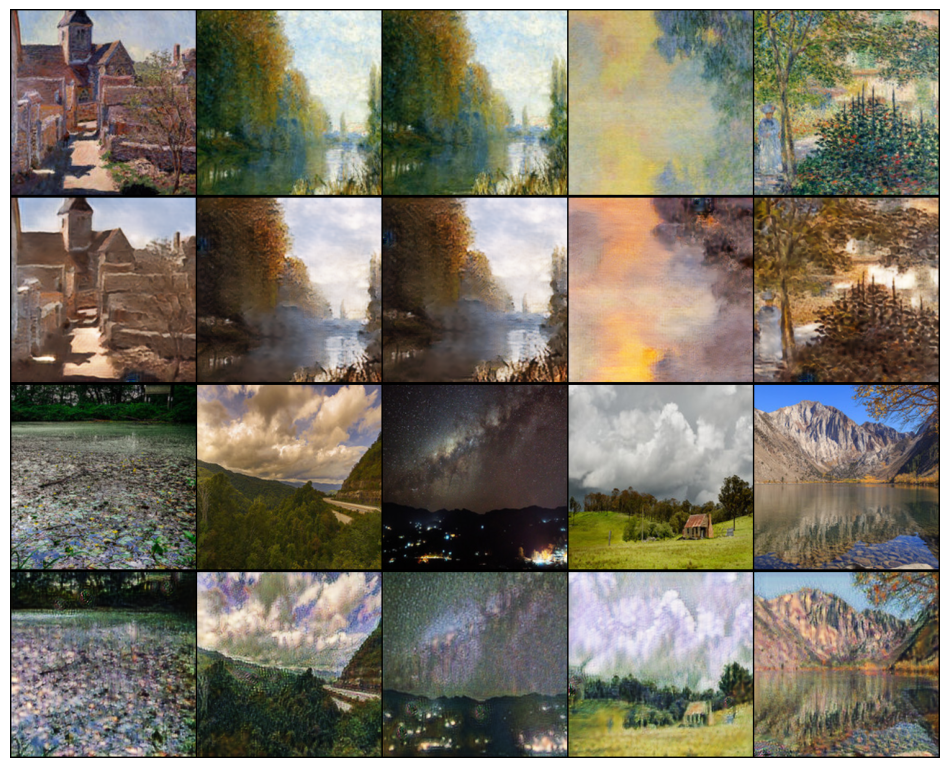

EPOCH: 8.000  loss_G: 2.729  loss_GAN: 0.650  loss_D: 0.141  loss_cycle: 0.142  loss_identity: 0.131  (14937.33s - 31741.83s remaining)
EPOCH: 9.000  loss_D: 0.094  loss_G: 1.770  loss_GAN: 0.533  loss_cycle: 0.085  loss_identity: 0.078  (16376.33s - 29113.47s remaining)

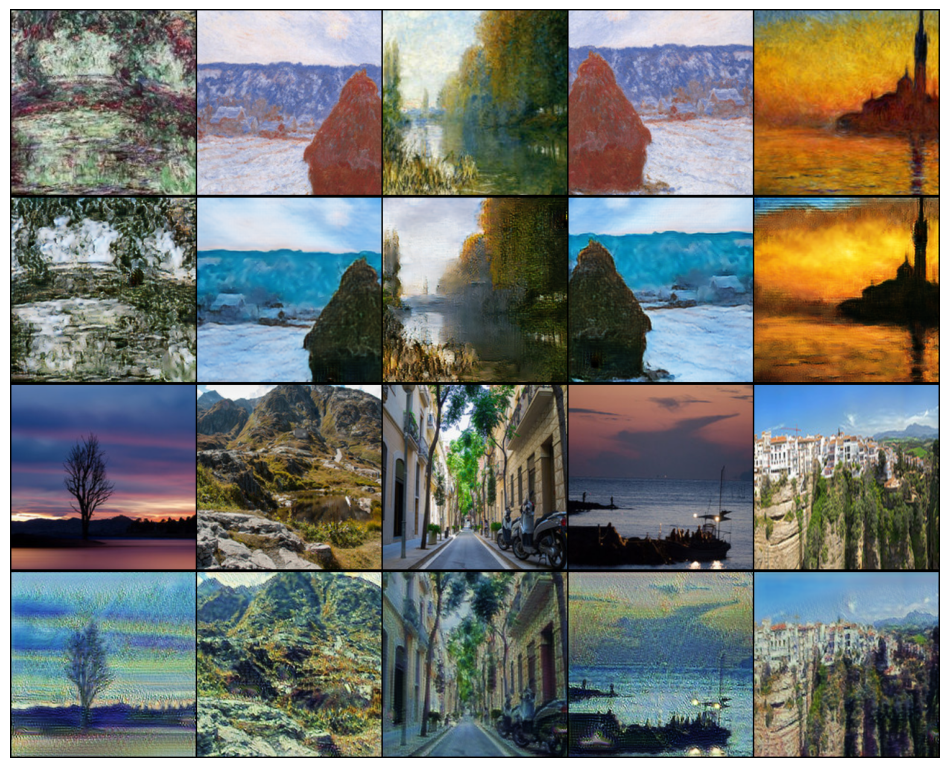

EPOCH: 9.000  loss_G: 2.706  loss_GAN: 0.662  loss_D: 0.136  loss_cycle: 0.140  loss_identity: 0.129  (16379.23s - 29118.63s remaining)
EPOCH: 10.000  loss_D: 0.277  loss_G: 2.166  loss_GAN: 0.371  loss_cycle: 0.113  loss_identity: 0.132  (17820.43s - 26730.64s remaining)

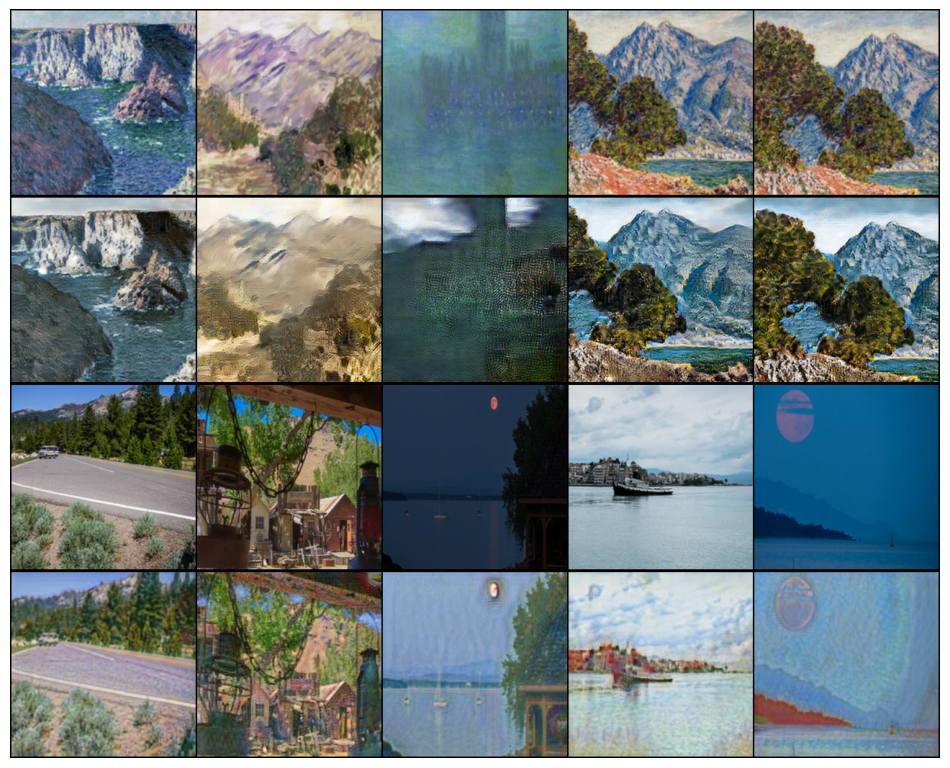

EPOCH: 10.000  loss_G: 2.656  loss_GAN: 0.668  loss_D: 0.133  loss_cycle: 0.136  loss_identity: 0.125  (17823.81s - 26735.72s remaining)
EPOCH: 11.000  loss_D: 0.145  loss_G: 2.229  loss_GAN: 0.718  loss_cycle: 0.108  loss_identity: 0.086  (19264.93s - 24519.01s remaining)

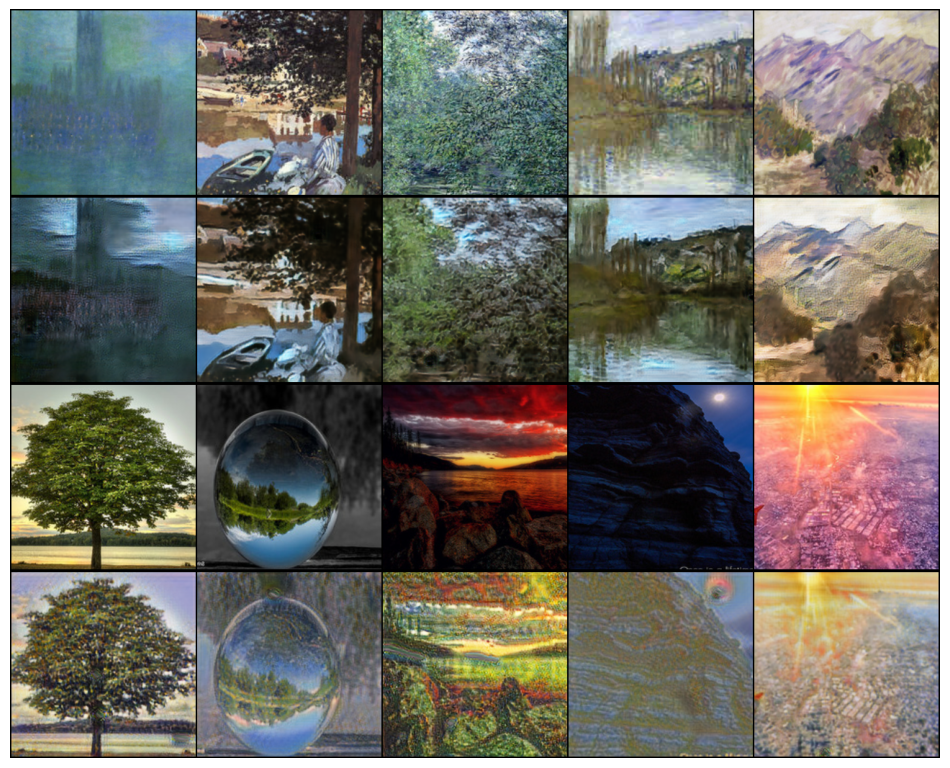

EPOCH: 11.000  loss_G: 2.647  loss_GAN: 0.684  loss_D: 0.128  loss_cycle: 0.135  loss_identity: 0.123  (19268.20s - 24523.17s remaining)
EPOCH: 12.000  loss_D: 0.078  loss_G: 3.531  loss_GAN: 0.977  loss_cycle: 0.184  loss_identity: 0.142  (20703.94s - 22429.27s remaining)

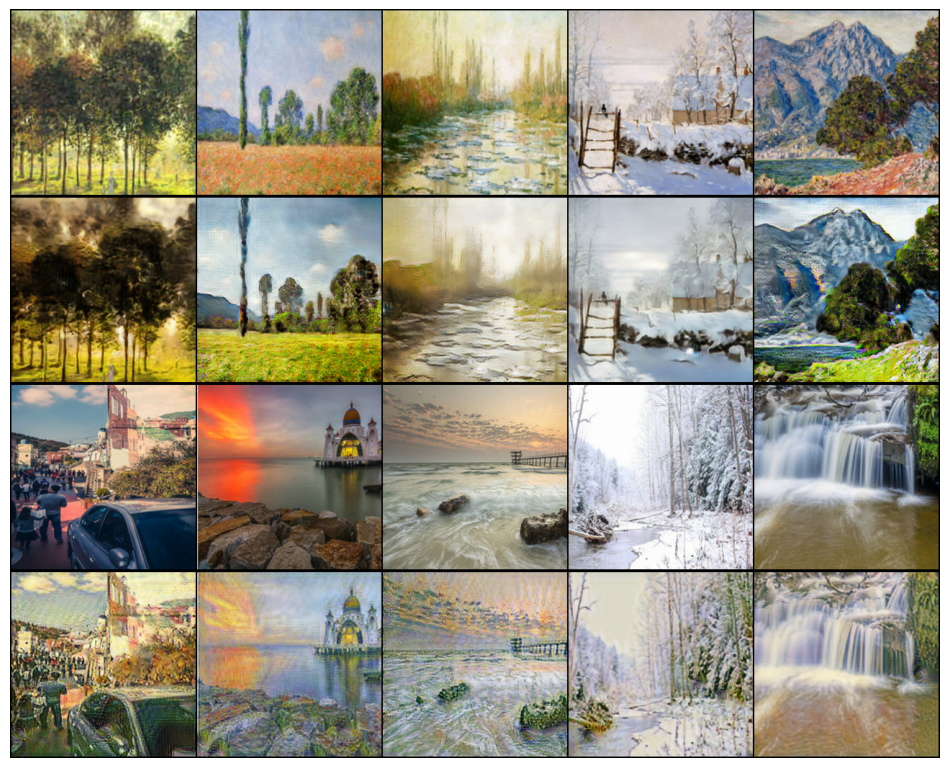

EPOCH: 12.000  loss_G: 2.591  loss_GAN: 0.677  loss_D: 0.130  loss_cycle: 0.132  loss_identity: 0.120  (20707.22s - 22432.82s remaining)
EPOCH: 13.000  loss_D: 0.133  loss_G: 2.334  loss_GAN: 0.829  loss_cycle: 0.103  loss_identity: 0.096  (22142.50s - 20439.23s remaining)

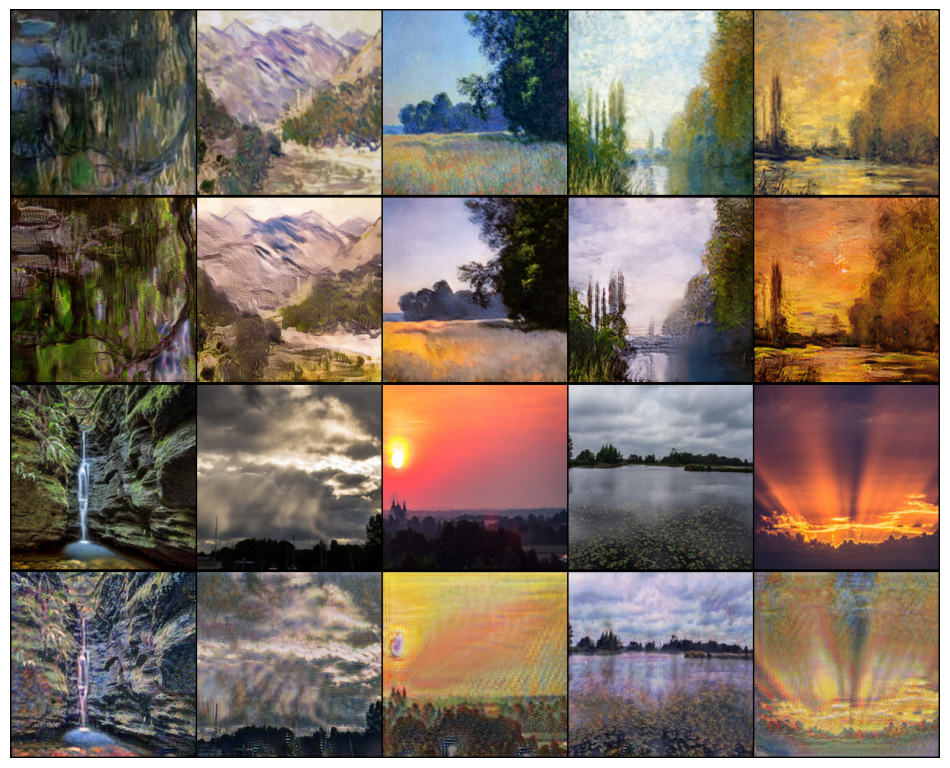

EPOCH: 13.000  loss_G: 2.588  loss_GAN: 0.689  loss_D: 0.124  loss_cycle: 0.131  loss_identity: 0.118  (22145.95s - 20442.42s remaining)
EPOCH: 14.000  loss_D: 0.048  loss_G: 2.778  loss_GAN: 1.010  loss_cycle: 0.133  loss_identity: 0.088  (23584.79s - 18530.90s remaining)

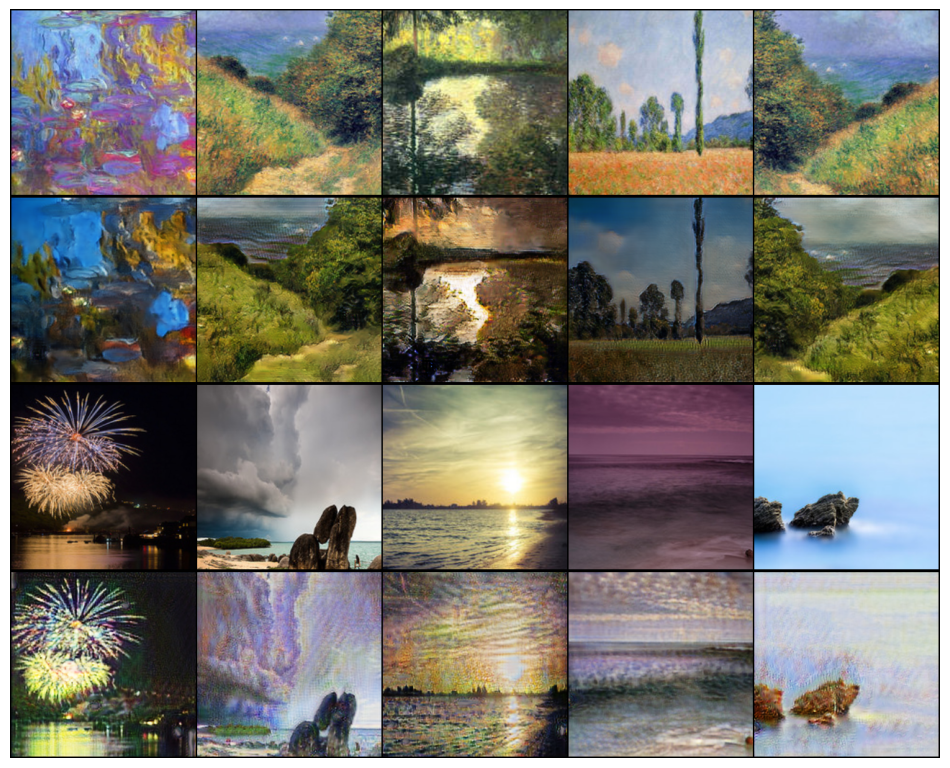

EPOCH: 14.000  loss_G: 2.560  loss_GAN: 0.701  loss_D: 0.121  loss_cycle: 0.128  loss_identity: 0.116  (23587.40s - 18532.96s remaining)
EPOCH: 15.000  loss_D: 0.088  loss_G: 2.698  loss_GAN: 1.061  loss_cycle: 0.090  loss_identity: 0.148  (25025.39s - 16683.59s remaining)

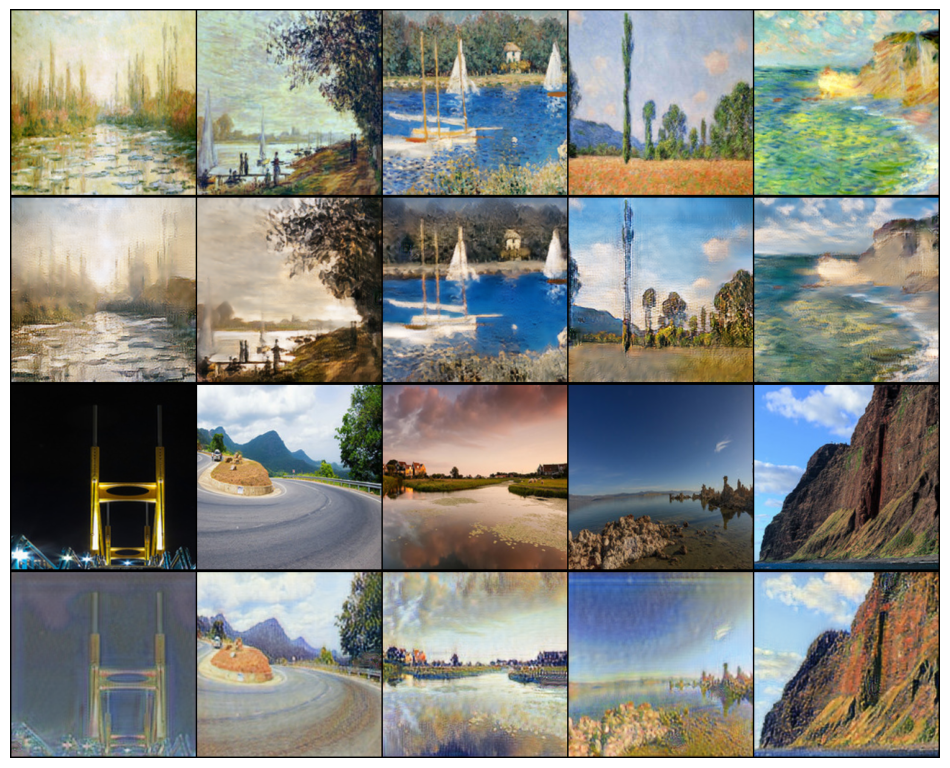

EPOCH: 15.000  loss_G: 2.548  loss_GAN: 0.704  loss_D: 0.119  loss_cycle: 0.127  loss_identity: 0.114  (25028.98s - 16685.99s remaining)
EPOCH: 16.000  loss_D: 0.157  loss_G: 2.260  loss_GAN: 0.464  loss_cycle: 0.130  loss_identity: 0.099  (26463.18s - 14885.54s remaining)

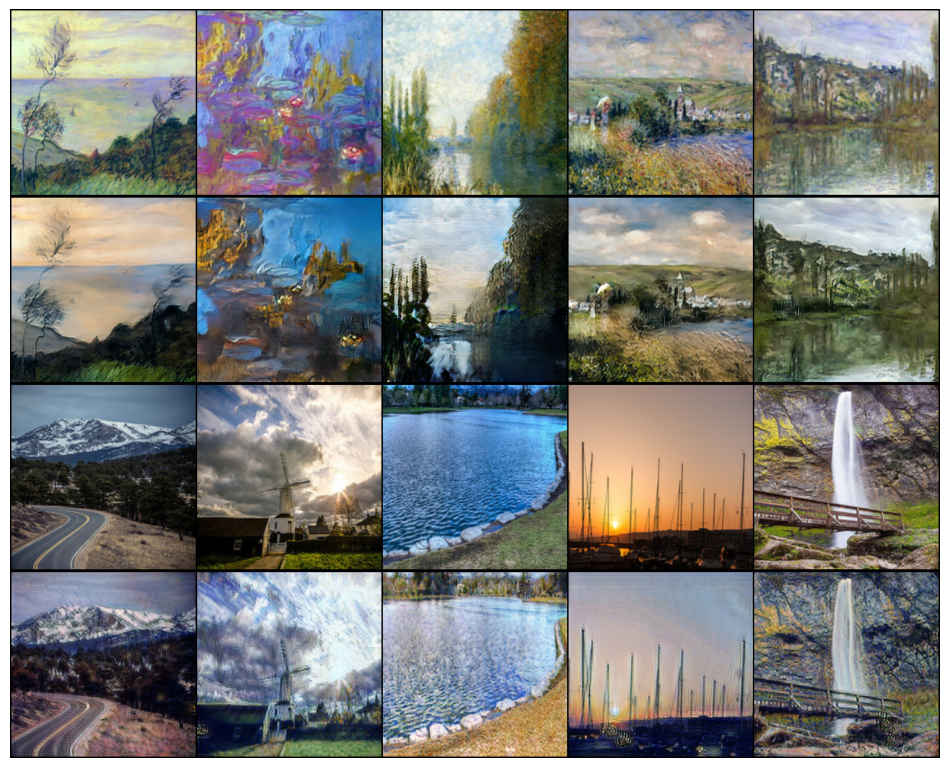

EPOCH: 16.000  loss_G: 2.537  loss_GAN: 0.720  loss_D: 0.114  loss_cycle: 0.126  loss_identity: 0.112  (26466.56s - 14887.44s remaining)
EPOCH: 17.000  loss_D: 0.200  loss_G: 2.579  loss_GAN: 0.422  loss_cycle: 0.148  loss_identity: 0.135  (27900.47s - 13129.64s remaining)

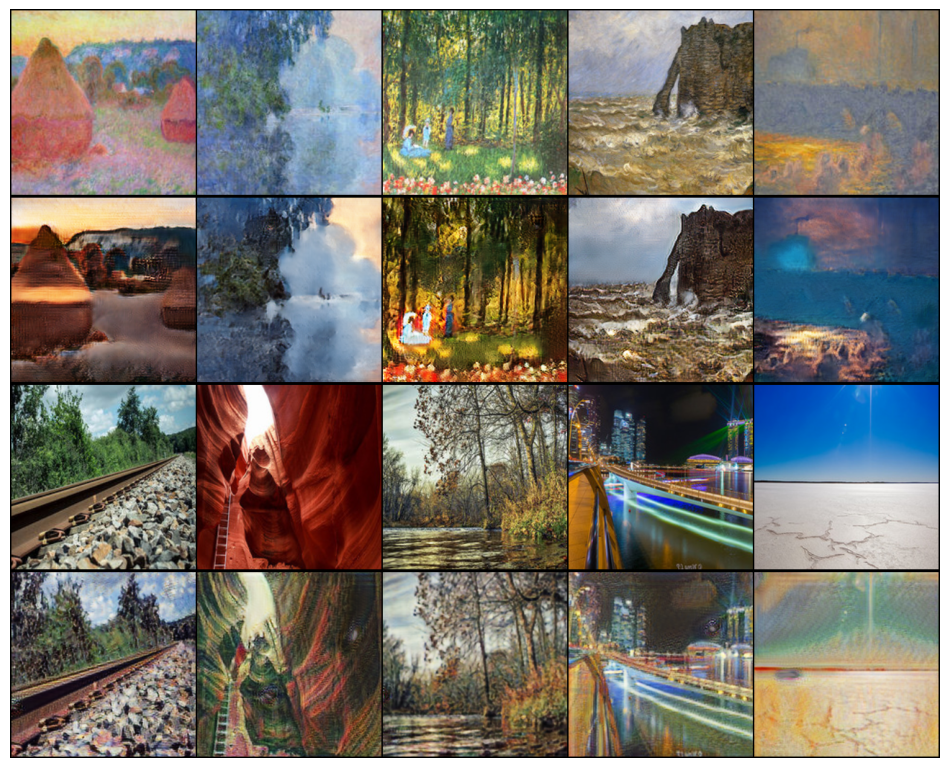

EPOCH: 17.000  loss_G: 2.545  loss_GAN: 0.740  loss_D: 0.107  loss_cycle: 0.125  loss_identity: 0.111  (27904.04s - 13131.31s remaining)
EPOCH: 18.000  loss_D: 0.112  loss_G: 2.200  loss_GAN: 0.777  loss_cycle: 0.090  loss_identity: 0.105  (29345.83s - 11412.27s remaining)

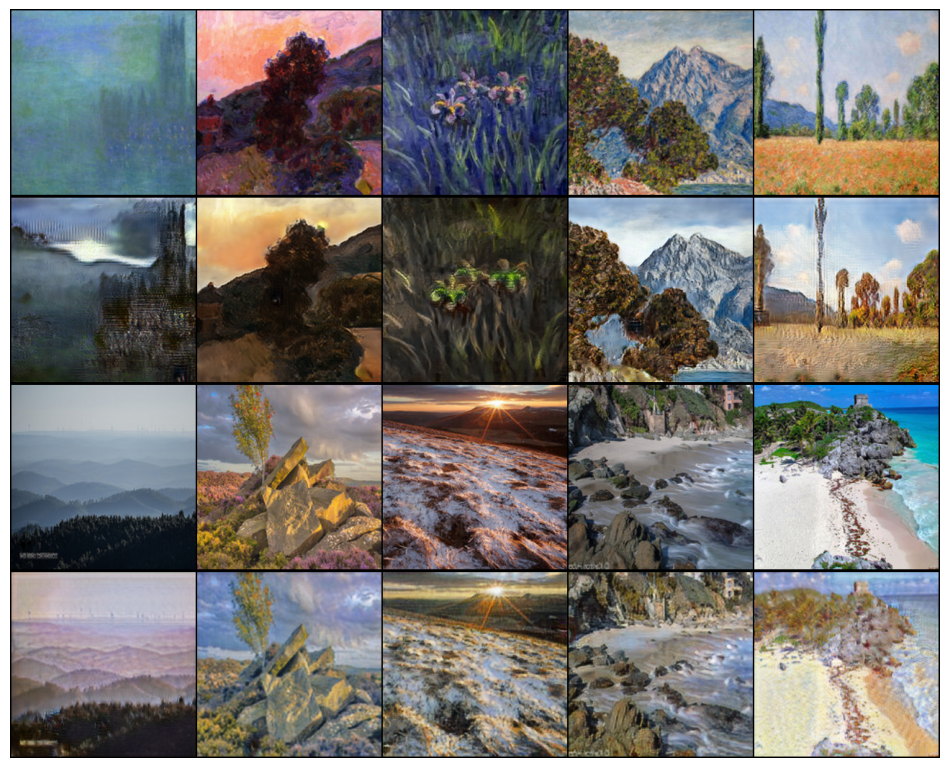

EPOCH: 18.000  loss_G: 2.531  loss_GAN: 0.747  loss_D: 0.104  loss_cycle: 0.124  loss_identity: 0.109  (29349.11s - 11413.54s remaining)
EPOCH: 19.000  loss_D: 0.143  loss_G: 2.295  loss_GAN: 0.812  loss_cycle: 0.099  loss_identity: 0.099  (30791.61s - 9723.67s remaining)

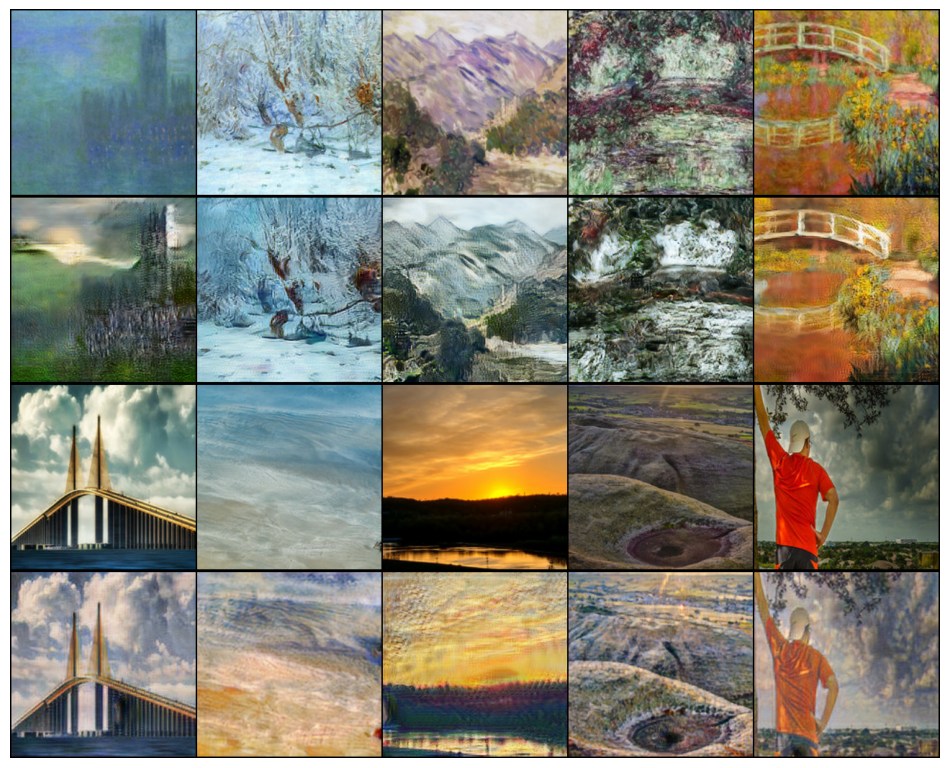

EPOCH: 19.000  loss_G: 2.508  loss_GAN: 0.752  loss_D: 0.102  loss_cycle: 0.122  loss_identity: 0.107  (30795.16s - 9724.79s remaining)
EPOCH: 20.000  loss_D: 0.114  loss_G: 1.850  loss_GAN: 0.652  loss_cycle: 0.084  loss_identity: 0.072  (32234.67s - 8058.67s remaining)

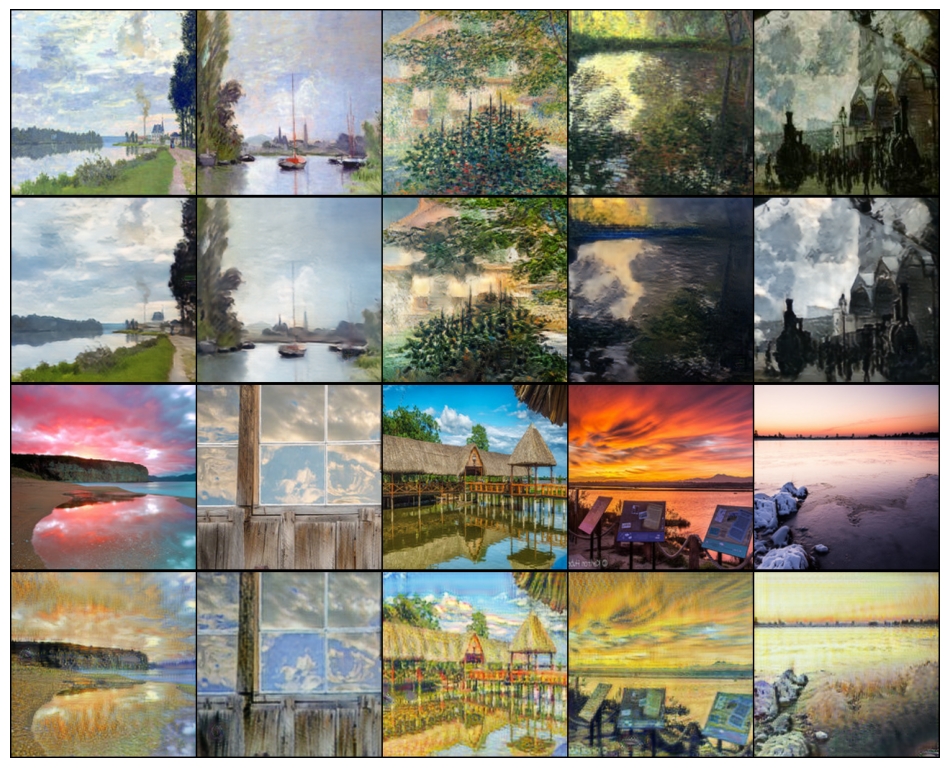

EPOCH: 20.000  loss_G: 2.510  loss_GAN: 0.756  loss_D: 0.101  loss_cycle: 0.122  loss_identity: 0.107  (32238.30s - 8059.57s remaining)
EPOCH: 21.000  loss_D: 0.068  loss_G: 2.597  loss_GAN: 0.722  loss_cycle: 0.136  loss_identity: 0.104  (33677.80s - 6414.82s remaining)

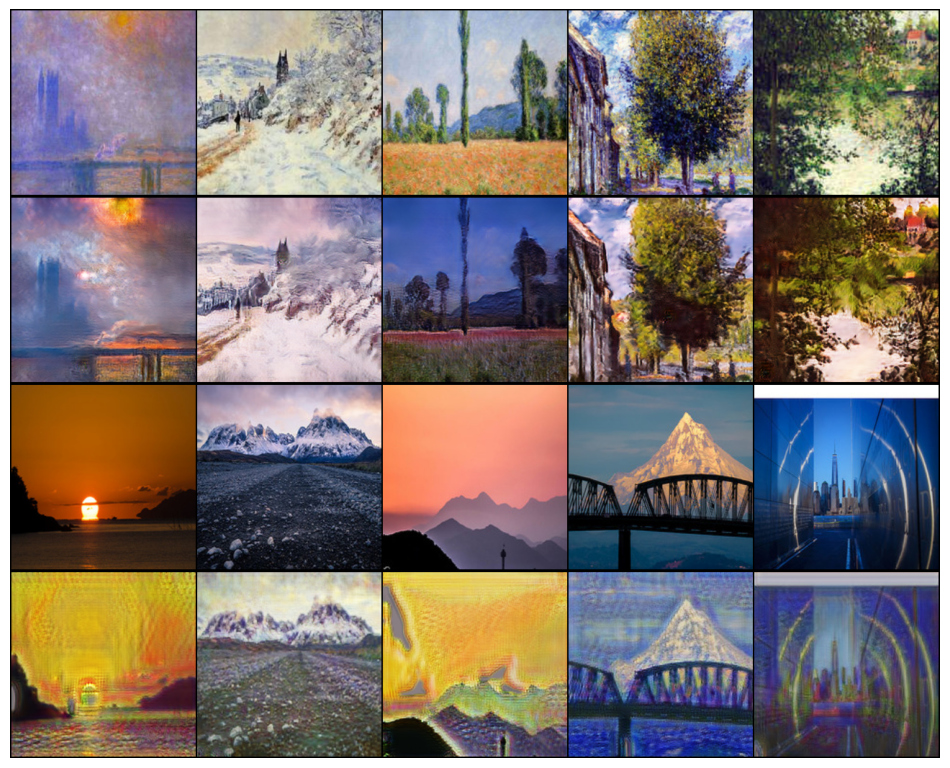

EPOCH: 21.000  loss_G: 2.484  loss_GAN: 0.761  loss_D: 0.099  loss_cycle: 0.120  loss_identity: 0.105  (33681.25s - 6415.48s remaining)
EPOCH: 22.000  loss_D: 0.104  loss_G: 2.621  loss_GAN: 0.654  loss_cycle: 0.121  loss_identity: 0.150  (35123.45s - 4789.56s remaining)

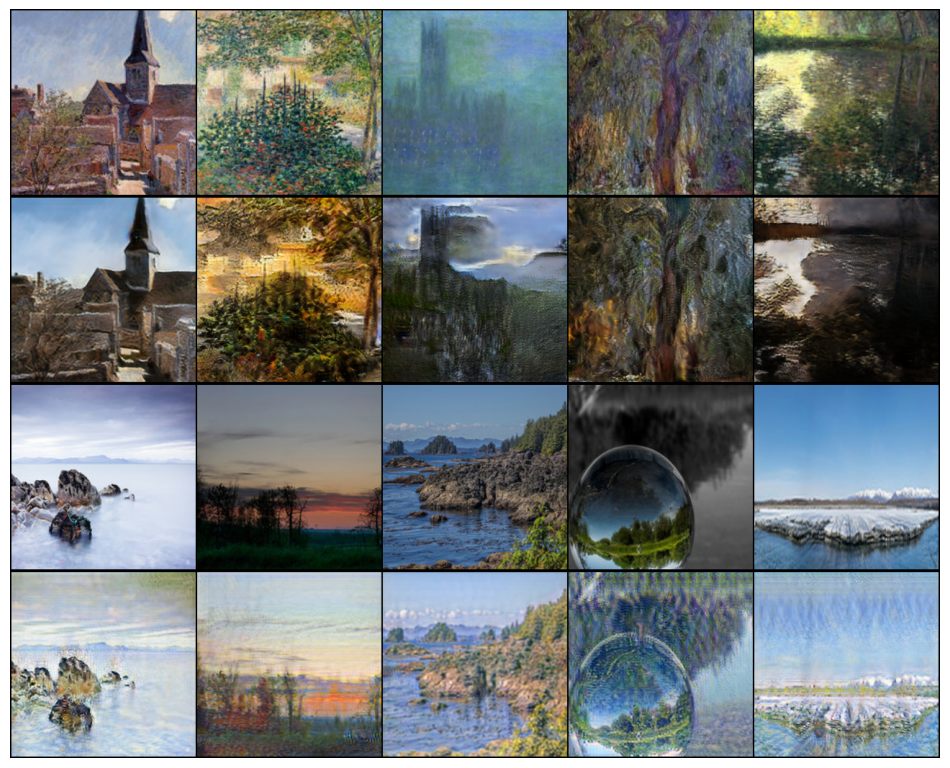

EPOCH: 22.000  loss_G: 2.474  loss_GAN: 0.762  loss_D: 0.098  loss_cycle: 0.119  loss_identity: 0.104  (35126.24s - 4789.94s remaining)
EPOCH: 23.000  loss_D: 0.179  loss_G: 1.924  loss_GAN: 0.341  loss_cycle: 0.116  loss_identity: 0.085  (36575.01s - 3180.44s remaining)

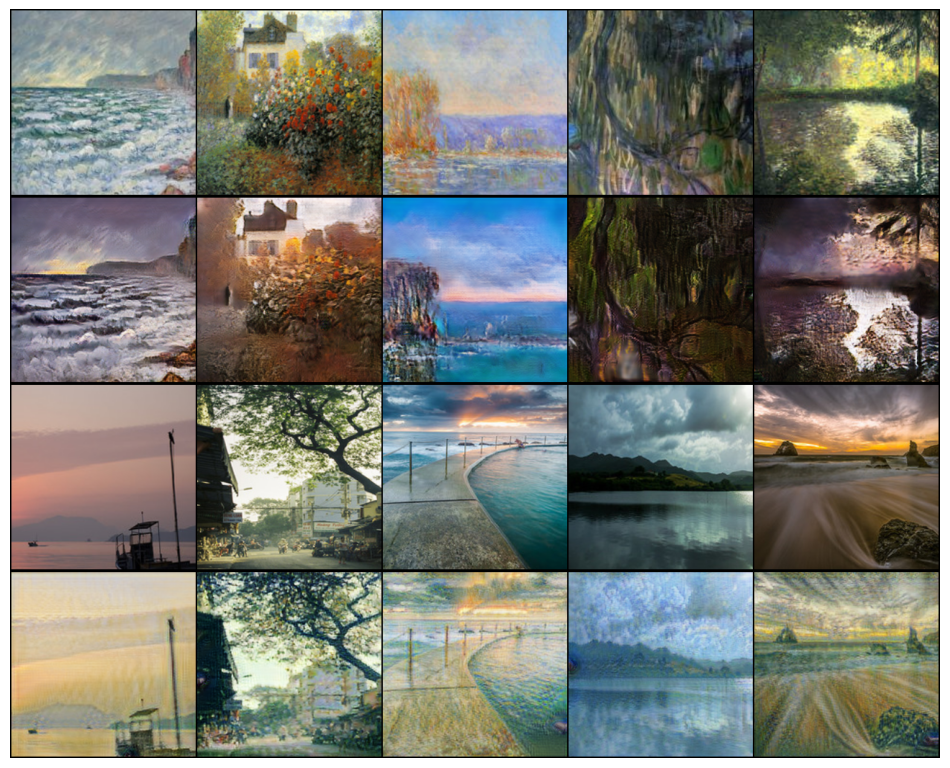

EPOCH: 23.000  loss_G: 2.457  loss_GAN: 0.765  loss_D: 0.097  loss_cycle: 0.118  loss_identity: 0.103  (36578.26s - 3180.72s remaining)
EPOCH: 24.000  loss_D: 0.054  loss_G: 2.550  loss_GAN: 1.024  loss_cycle: 0.097  loss_identity: 0.112  (38018.29s - 1584.10s remaining)

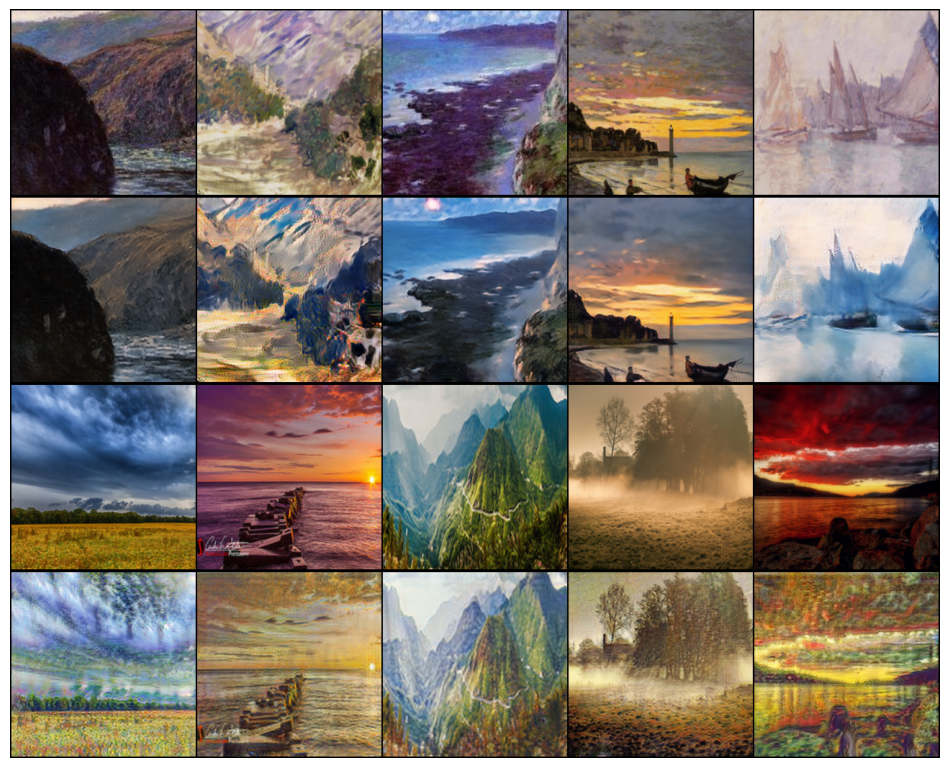

EPOCH: 24.000  loss_G: 2.458  loss_GAN: 0.768  loss_D: 0.095  loss_cycle: 0.118  loss_identity: 0.102  (38020.77s - 1584.20s remaining)
EPOCH: 25.000  loss_D: 0.067  loss_G: 2.018  loss_GAN: 0.702  loss_cycle: 0.098  loss_identity: 0.068  (39458.93s - 0.00s remaining)

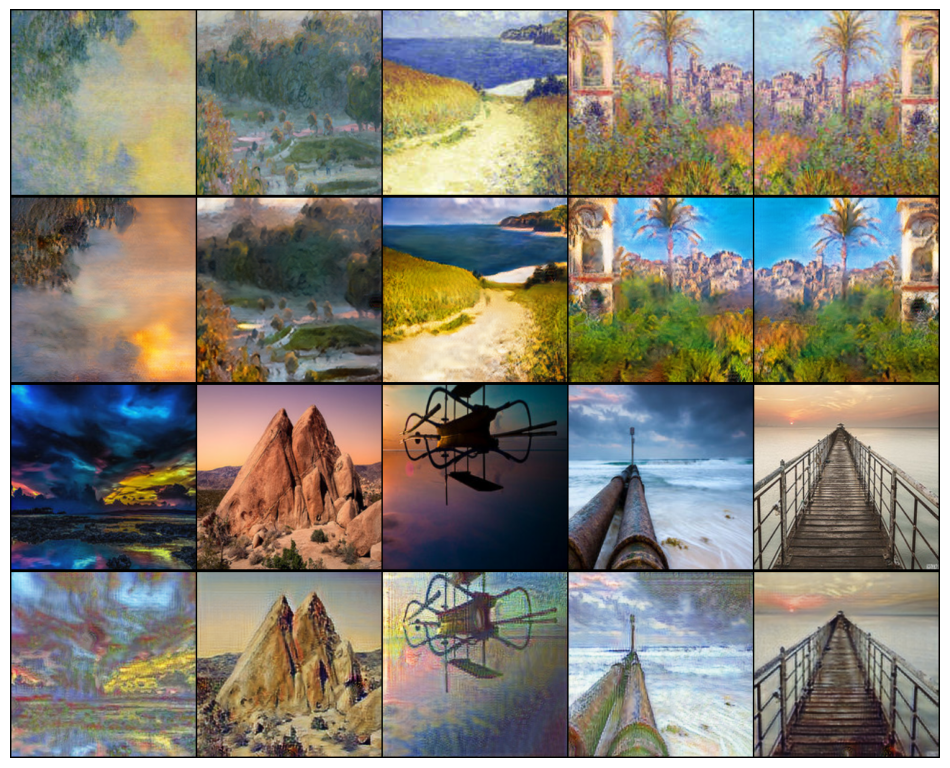

EPOCH: 25.000  loss_G: 2.448  loss_GAN: 0.773  loss_D: 0.095  loss_cycle: 0.117  loss_identity: 0.101  (39462.52s - 0.00s remaining)


In [15]:
n_epochs = 25
log = Report(n_epochs)
for epoch in range(n_epochs):
    N = len(trn_dl)
    for bx, batch in enumerate(trn_dl):
        real_A, real_B = batch

        loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B = generator_train_step((G_AB,G_BA), optimizer_G, real_A, real_B)
        loss_D_A = discriminator_train_step(D_A, real_A, fake_A, optimizer_D_A)
        loss_D_B = discriminator_train_step(D_B, real_B, fake_B, optimizer_D_B)
        loss_D = (loss_D_A + loss_D_B) / 2

        log.record(epoch+(1+bx)/N, loss_D=loss_D.item(), loss_G=loss_G.item(),
                   loss_GAN=loss_GAN.item(), loss_cycle=loss_cycle.item(),
                   loss_identity=loss_identity.item(), end='\r')
    generate_sample()

    log.report_avgs(epoch+1)

100%|██████████| 126/126 [00:19<00:00,  6.45it/s]


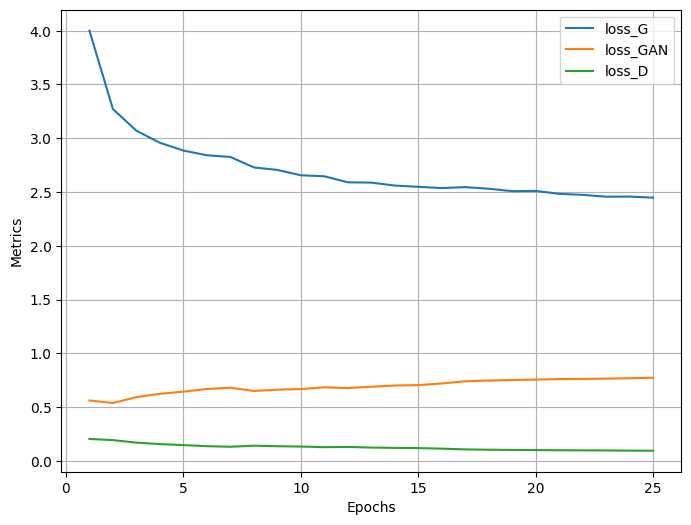

In [16]:
log.plot_epochs(['loss_G','loss_GAN', 'loss_D'])

In [26]:
# Save generator A (monet) to B (Photo)
torch.save(G_AB.state_dict(), '/content/drive/MyDrive/DLHW6/G_AB_cycle_gan_model.pth')

# Save generator B (photo) to A (Monet)
torch.save(G_BA.state_dict(), '/content/drive/MyDrive/DLHW6/G_BA_cycle_gan_model.pth')

In [27]:
model = GeneratorResNet()
model.load_state_dict(torch.load('/content/drive/MyDrive/DLHW6/G_AB_cycle_gan_model.pth'))
model.eval()  # Set the model to evaluation mode

GeneratorResNet(
  (model): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1))
    (2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (3): ReLU(inplace=True)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (9): ReLU(inplace=True)
    (10): ResidualBlock(
      (block): Sequential(
        (0): ReflectionPad2d((1, 1, 1, 1))
        (1): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1))
        (2): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
        (3): ReLU(inplace=True)
        (4): ReflectionPad2d((1, 1, 1, 1))
        

In [28]:
import torchvision.transforms as transforms
from PIL import Image

# Load and preprocess the input image
input_image = Image.open('/content/drive/MyDrive/DLHW6/rickgosalvez.jpg')
preprocess = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize the image to the model's input size
    transforms.ToTensor(),  # Convert the image to tensor
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))  # Normalize the image
])
input_tensor = preprocess(input_image).unsqueeze(0)  # Add batch dimension

# Perform inference
with torch.no_grad():
    output_image = model(input_tensor)

# Convert the output tensor to an image
output_image = output_image.squeeze(0).cpu().detach()
output_image = transforms.ToPILImage()(output_image)

# Save or display the output image
output_image.save('/content/drive/MyDrive/DLHW6/G_AB_rickgosalvez_output_image.jpg')
output_image.show()

In [29]:
import torchvision.transforms as transforms
from PIL import Image

# Load and preprocess the input image
input_image = Image.open('/content/drive/MyDrive/DLHW6/sjsu.jpg')
preprocess = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize the image to the model's input size
    transforms.ToTensor(),  # Convert the image to tensor
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))  # Normalize the image
])
input_tensor = preprocess(input_image).unsqueeze(0)  # Add batch dimension

# Perform inference
with torch.no_grad():
    output_image = model(input_tensor)

# Convert the output tensor to an image
output_image = output_image.squeeze(0).cpu().detach()
output_image = transforms.ToPILImage()(output_image)

# Save or display the output image
output_image.save('/content/drive/MyDrive/DLHW6/G_AB_sjsu_output_image.jpg')
output_image.show()

In [30]:
model = GeneratorResNet()
model.load_state_dict(torch.load('/content/drive/MyDrive/DLHW6/G_BA_cycle_gan_model.pth'))
model.eval()  # Set the model to evaluation mode

GeneratorResNet(
  (model): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1))
    (2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (3): ReLU(inplace=True)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (9): ReLU(inplace=True)
    (10): ResidualBlock(
      (block): Sequential(
        (0): ReflectionPad2d((1, 1, 1, 1))
        (1): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1))
        (2): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
        (3): ReLU(inplace=True)
        (4): ReflectionPad2d((1, 1, 1, 1))
        

In [33]:
import torchvision.transforms as transforms
from PIL import Image

# Load and preprocess the input image
input_image = Image.open('/content/drive/MyDrive/DLHW6/rickgosalvez.jpg')
preprocess = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize the image to the model's input size
    transforms.ToTensor(),  # Convert the image to tensor
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))  # Normalize the image
])
input_tensor = preprocess(input_image).unsqueeze(0)  # Add batch dimension

# Perform inference
with torch.no_grad():
    output_image = model(input_tensor)

# Convert the output tensor to an image
output_image = output_image.squeeze(0).cpu().detach()
output_image = transforms.ToPILImage()(output_image)

# Save or display the output image
output_image.save('/content/drive/MyDrive/DLHW6/G_BA_rickgosalvez_output_image.jpg')
output_image.show()

In [32]:
import torchvision.transforms as transforms
from PIL import Image

# Load and preprocess the input image
input_image = Image.open('/content/drive/MyDrive/DLHW6/sjsu.jpg')
preprocess = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize the image to the model's input size
    transforms.ToTensor(),  # Convert the image to tensor
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))  # Normalize the image
])
input_tensor = preprocess(input_image).unsqueeze(0)  # Add batch dimension

# Perform inference
with torch.no_grad():
    output_image = model(input_tensor)

# Convert the output tensor to an image
output_image = output_image.squeeze(0).cpu().detach()
output_image = transforms.ToPILImage()(output_image)

# Save or display the output image
output_image.save('/content/drive/MyDrive/DLHW6/G_BA_sjsu_output_image.jpg')
output_image.show()